# ICS 483 Term Project
#### Chest X-Ray Images (Pneumonia)

### Setup

In [ ]:
# Import Libraries
import matplotlib.pyplot as plt
import numpy as np
import cv2
import os
import tensorflow as tf
from tensorflow import keras
import tensorflow.keras.utils as utils
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.optimizers import Adam as adam

## 1. Images Preprocessing 

In [ ]:
def process_img_sobel(filename, newfilename):
    # Load the image using the flag 1 so the image is a BGR 3 channel image
    image = cv2.imread(filename, 1)

    # Convert the BGR image to an RGB image
    rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Normalize the image pixels
    normalized_img = rgb_img # skipping this step for now  /255

    # Resize the image to the desired dimensions
    width = 1024
    height = 1024
    resized_img = cv2.resize(normalized_img, (width, height))

    # Define the Sobel filters

    sobel_x = np.array([[1, 0, -1],
                        [2, 0, -2],
                        [1, 0, -1]])

    sobel_y = np.array([[1, 2, 1],
                        [0, 0, 0],
                        [-1, -2, -1]])

    # Apply the kernels using cv2.filter2D()
    filtered_img_x = cv2.filter2D(resized_img, -1, sobel_x)
    filtered_img_y = cv2.filter2D(resized_img, -1, sobel_y)
    filtered_img = filtered_img_x + filtered_img_y

    # Save the processed image with the same filename but in a different directory
    cv2.imwrite(newfilename, filtered_img)

In [ ]:
def process_img_equalization(filename, newfilename):
    # Load the image using the flag 1 so the image is a BGR 3 channel image
    image = cv2.imread(filename, 1)

    # Convert the BGR image to an Grayscale image
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Normalize the image pixels
    normalized_img = gray # skipping this step for now  /255

    # Resize the image to the desired dimensions
    width = 1024
    height = 1024
    resized_img = cv2.resize(normalized_img, (width, height))

    # apply adaptive histogram equalization (using CLAHE)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    equalized_img = clahe.apply(resized_img)

    # Save the processed image with the same filename but in a different directory
    cv2.imwrite(newfilename, equalized_img)

In [ ]:
def process_img_both(filename, newfilename):
    # Load the image using the flag 1 so the image is a BGR 3 channel image
    image = cv2.imread(filename, 1)

    # Convert the BGR image to an RGB image
    rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Normalize the image pixels
    normalized_img = rgb_img # skipping this step for now  /255

    # Resize the image to the desired dimensions
    width = 1024
    height = 1024
    resized_img = cv2.resize(normalized_img, (width, height))

    # Define the Sobel filters

    sobel_x = np.array([[1, 0, -1],
                        [2, 0, -2],
                        [1, 0, -1]])

    sobel_y = np.array([[1, 2, 1],
                        [0, 0, 0],
                        [-1, -2, -1]])

    # Apply the kernels using cv2.filter2D()
    filtered_img_x = cv2.filter2D(resized_img, -1, sobel_x)
    filtered_img_y = cv2.filter2D(resized_img, -1, sobel_y)
    filtered_img = filtered_img_x + filtered_img_y

    #apply adaptive histogram equalization on the filtered image
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    gray = cv2.cvtColor(filtered_img, cv2.COLOR_BGR2GRAY)
    processed_img = clahe.apply(gray)

    # Save the processed image with the same filename but in a different directory
    cv2.imwrite(newfilename, processed_img)

### Images before applying any process

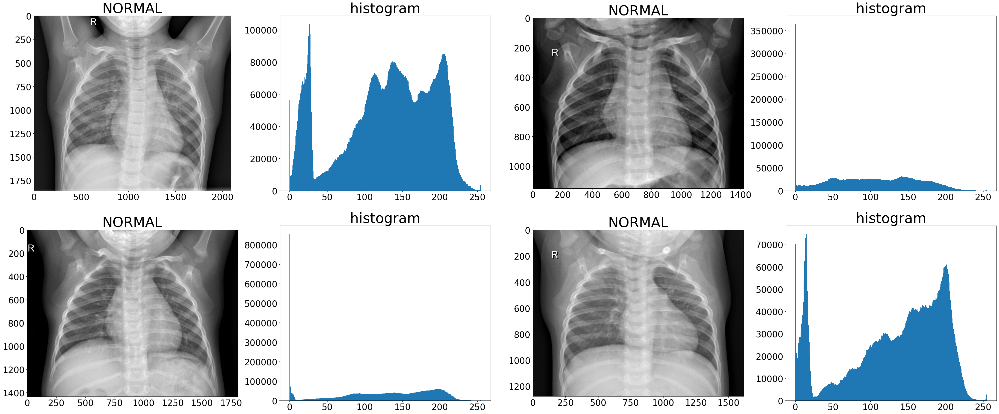

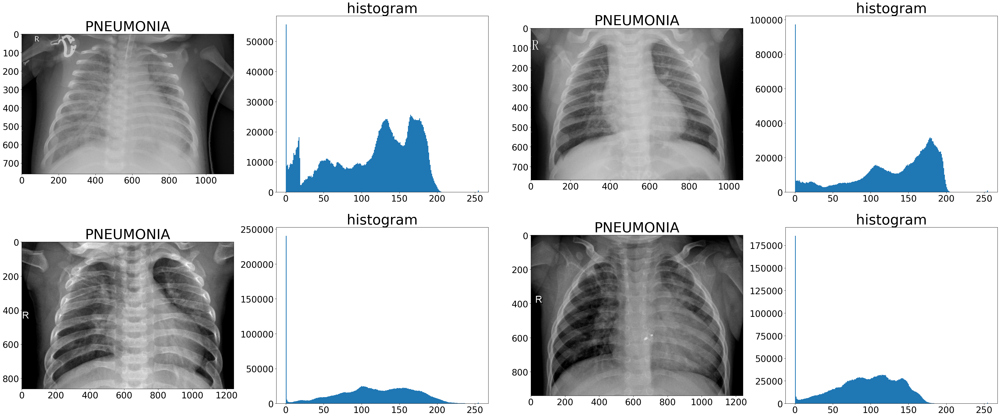

In [ ]:
train_images_path_NORMAL = os.getcwd() + r"\chest_xray\train\NORMAL"
train_images_path_PNEUMONIA = os.getcwd() + r"\chest_xray\train\PNEUMONIA"

i = 0
plt.figure(figsize=(50, 20))
plt.rcParams['font.size'] = 25
for filename in os.listdir(train_images_path_NORMAL):
    if(i < 8):
        image_path = os.path.join(train_images_path_NORMAL, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("NORMAL", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

i = 0
plt.figure(figsize=(50, 20))
for filename in os.listdir(train_images_path_PNEUMONIA):
    if(i < 8):
        image_path = os.path.join(train_images_path_PNEUMONIA, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("PNEUMONIA", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

### Applying Sobel

In [ ]:
# Set the directory containing the images
directory = "chest_xray"

# Set the directory in which to save the processed images
newdirectory = "chest_xray_sobel"

# Loop through all the files in the directory
for folder in os.listdir(directory):
    for foldr in os.listdir(os.path.join(directory, folder)):
        for filename in os.listdir(os.path.join(directory, folder, foldr)):
            if filename.endswith(".jpeg"):

                filename_with_path = os.path.join(directory, folder, foldr, filename)
                newfilename = os.path.join(newdirectory, folder, foldr, filename)
                process_img_sobel(filename_with_path, newfilename)

### Images after applying sobel

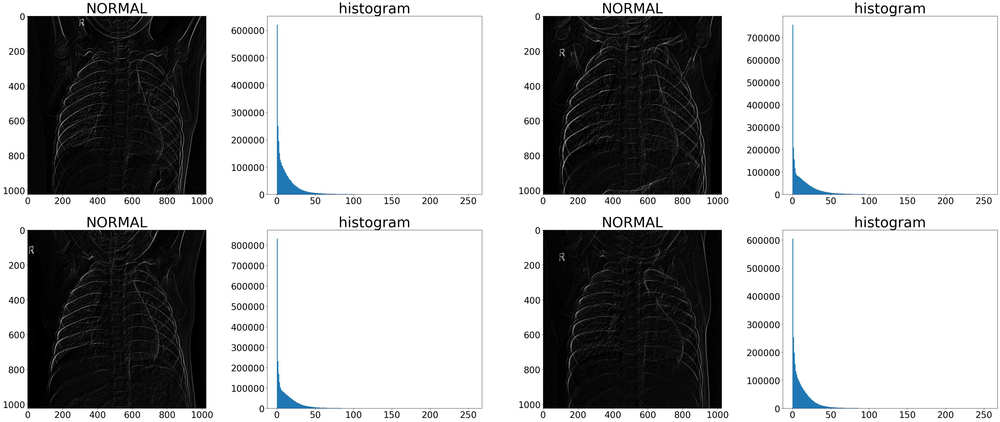

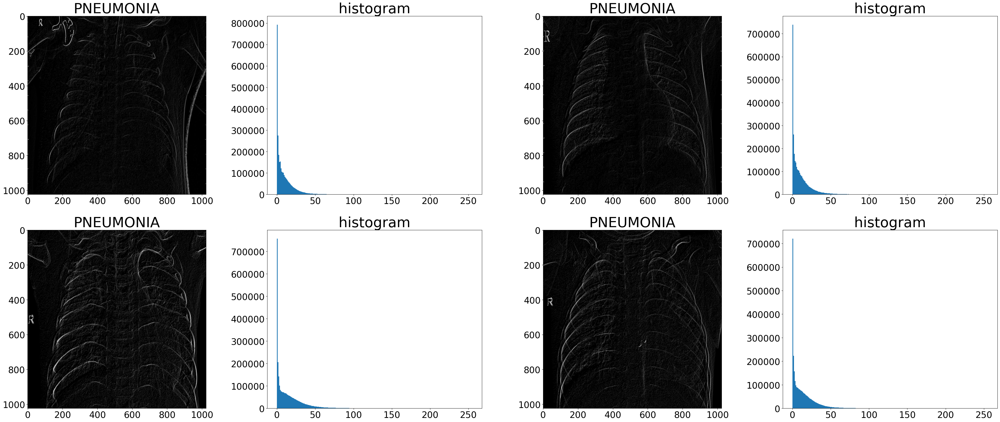

In [ ]:
train_images_path_NORMAL = os.getcwd() + r"\chest_xray_sobel\train\NORMAL"
train_images_path_PNEUMONIA = os.getcwd() + r"\chest_xray_sobel\train\PNEUMONIA"

i = 0
plt.figure(figsize=(50, 20))
plt.rcParams['font.size'] = 25
for filename in os.listdir(train_images_path_NORMAL):
    if(i < 8):
        image_path = os.path.join(train_images_path_NORMAL, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("NORMAL", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

i = 0
plt.figure(figsize=(50, 20))
for filename in os.listdir(train_images_path_PNEUMONIA):
    if(i < 8):
        image_path = os.path.join(train_images_path_PNEUMONIA, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("PNEUMONIA", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

### Applying Equalization

In [ ]:
#repeat the process for equalization method
# Set the directory in which to save the processed images
newdirectory = "chest_xray_equalization"

# Loop through all the files in the directory
for folder in os.listdir(directory):
    for foldr in os.listdir(os.path.join(directory, folder)):
        for filename in os.listdir(os.path.join(directory, folder, foldr)):
            if filename.endswith(".jpeg"):
                filename_with_path = os.path.join(directory, folder, foldr, filename)
                newfilename = os.path.join(newdirectory, folder, foldr, filename)
                process_img_equalization(filename_with_path, newfilename)

### Images after applying equalization

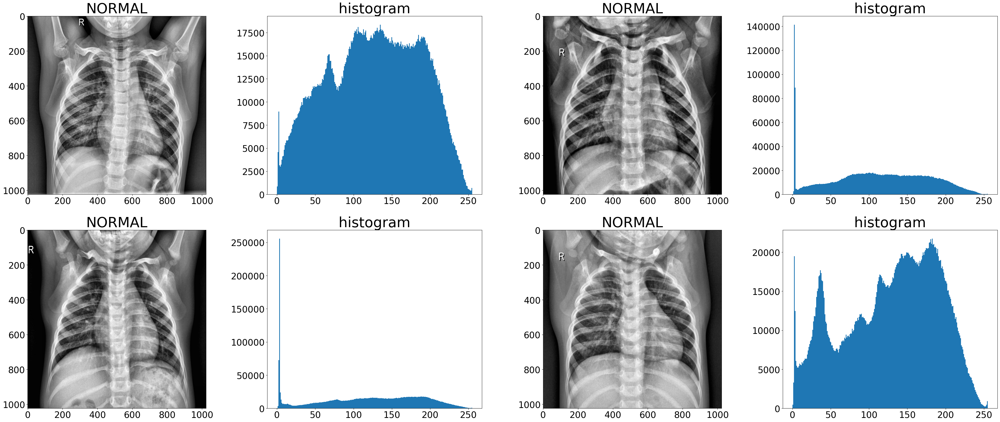

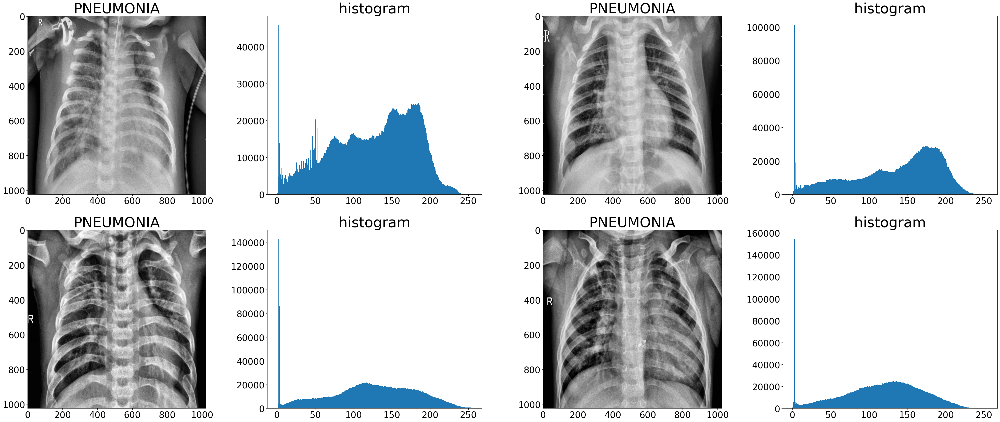

In [ ]:
train_images_path_NORMAL = os.getcwd() + r"\chest_xray_equalization\train\NORMAL"
train_images_path_PNEUMONIA = os.getcwd() + r"\chest_xray_equalization\train\PNEUMONIA"

i = 0
plt.figure(figsize=(50, 20))
plt.rcParams['font.size'] = 25
for filename in os.listdir(train_images_path_NORMAL):
    if(i < 8):
        image_path = os.path.join(train_images_path_NORMAL, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("NORMAL", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

i = 0
plt.figure(figsize=(50, 20))
for filename in os.listdir(train_images_path_PNEUMONIA):
    if(i < 8):
        image_path = os.path.join(train_images_path_PNEUMONIA, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("PNEUMONIA", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

### Applying both Sobel and Equalization

In [ ]:
#repeat the process for both methods together
# Set the directory in which to save the processed images
newdirectory = "chest_xray_both"

# Loop through all the files in the directory
for folder in os.listdir(directory):
    for foldr in os.listdir(os.path.join(directory, folder)):
        for filename in os.listdir(os.path.join(directory, folder, foldr)):
            if filename.endswith(".jpeg"):

                filename_with_path = os.path.join(directory, folder, foldr, filename)
                newfilename = os.path.join(newdirectory, folder, foldr, filename)
                process_img_both(filename_with_path, newfilename)

### Images after applying sobel and equalization

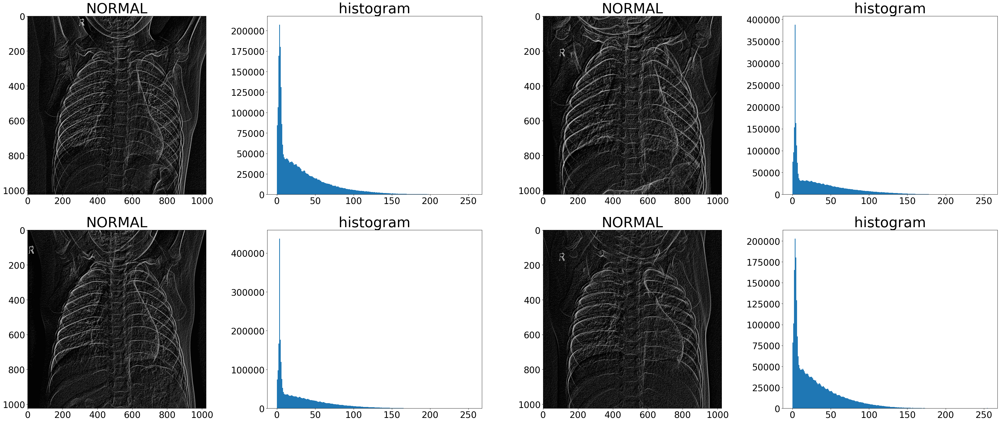

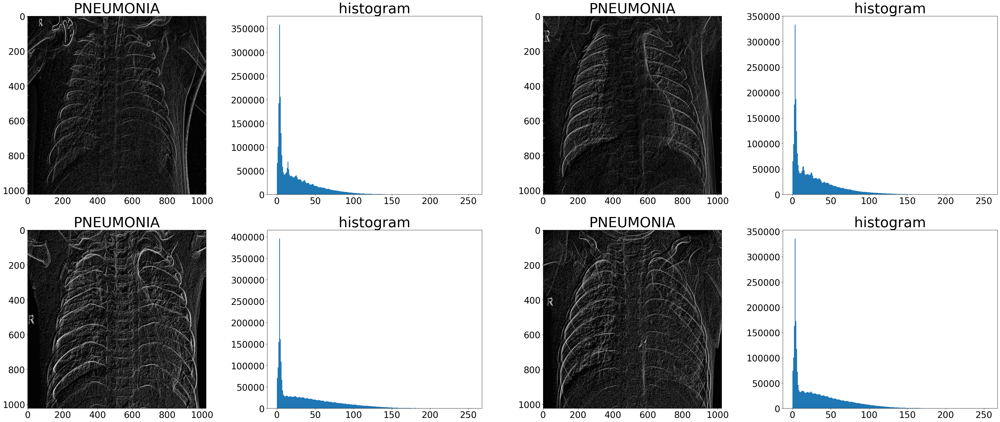

In [ ]:
train_images_path_NORMAL = os.getcwd() + r"\chest_xray_both\train\NORMAL"
train_images_path_PNEUMONIA = os.getcwd() + r"\chest_xray_both\train\PNEUMONIA"

i = 0
plt.figure(figsize=(50, 20))
plt.rcParams['font.size'] = 25
for filename in os.listdir(train_images_path_NORMAL):
    if(i < 8):
        image_path = os.path.join(train_images_path_NORMAL, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("NORMAL", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

i = 0
plt.figure(figsize=(50, 20))
for filename in os.listdir(train_images_path_PNEUMONIA):
    if(i < 8):
        image_path = os.path.join(train_images_path_PNEUMONIA, filename)
        image = cv2.imread(image_path, 1)
        rgb_img = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        ax = plt.subplot(2, 4, i + 1)
        plt.imshow(rgb_img.astype("uint8"))
        plt.title("PNEUMONIA", fontsize="40")
        i = i + 1
        ax = plt.subplot(2, 4, i + 1)
        plt.hist(rgb_img.ravel(),256,[0,255])
        plt.title('histogram', fontsize="40")
        i = i + 1
    else:
        plt.show()
        break

## 2. Prediction using Convolutional Neural Networks (CNN)

### Define hyperparameters

In [ ]:
IMG_SIZE = 256
BATCH_SIZE = 16
EPOCHS = 20

### Data preparation

In [ ]:
# Dataset path
train_ds_path = os.getcwd() + r"\chest_xray_both\train"
val_ds_path = os.getcwd() + r"\chest_xray_both\val"
test_ds_path = os.getcwd() + r"\chest_xray_both\test"

# Creating training dataset
train_ds = keras.utils.image_dataset_from_directory(
directory=train_ds_path,
labels='inferred',
label_mode='categorical',
batch_size=BATCH_SIZE,
image_size=(IMG_SIZE, IMG_SIZE))

# Creating validation dataset
val_ds = keras.utils.image_dataset_from_directory(
directory=val_ds_path,
labels='inferred',
label_mode='categorical',
batch_size=BATCH_SIZE,
image_size=(IMG_SIZE, IMG_SIZE))

# Creating testing dataset
test_ds = keras.utils.image_dataset_from_directory(
directory=test_ds_path,
labels='inferred',
label_mode='categorical',
batch_size=BATCH_SIZE,
image_size=(IMG_SIZE, IMG_SIZE))

Found 5216 files belonging to 2 classes.
Found 16 files belonging to 2 classes.
Found 624 files belonging to 2 classes.


In [ ]:
class_names = train_ds.class_names
print("Class names:")
print(class_names)

Class names:
['NORMAL', 'PNEUMONIA']


In [ ]:
for image_batch, labels_batch in train_ds:
    print(image_batch.shape)
    print(labels_batch.shape)
    break

(16, 256, 256, 3)
(16, 2)


The image_batch is a tensor of the shape (16, 256, 256, 3). 

This is a batch of 16 images of shape 256x256x3.

The last dimension refers to color channels RGB.

The label_batch is a tensor of the shape (16,2), these are corresponding labels to the 16 images.

### Build the model

In [ ]:
# Define the CNN model
model = keras.applications.InceptionV3(weights=None, input_shape=(IMG_SIZE, IMG_SIZE, 3), classes=2)

# Specify an optimizer and a loss function and a metric
model.compile(optimizer=adam(learning_rate=1e-3), loss='categorical_crossentropy', metrics=['accuracy'])

### Model summary
View all the layers of the network using the Keras Model.summary method:

In [ ]:
model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 127, 127, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 127, 127, 32) 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, 127, 127, 32) 0           batch_normalization[0][0]        
_______________________________________________________________________________________

### Training the model

In [ ]:
# training the model with Early stopping technique
early_stopping = EarlyStopping(monitor='val_accuracy', patience=5)

# save the best model (lowest validation accuracy) in the experiment
checkPoints = ModelCheckpoint(filepath="K:/PythonProjects/ICS483/Project/best_model.h5", verbose = 1, save_best_only = True)

# start training
modelHistory = model.fit(train_ds, validation_data=val_ds, epochs=EPOCHS, callbacks=[early_stopping, checkPoints])

Epoch 1/20
326/326 [==============================] - 109s 278ms/step - loss: 0.2634 - accuracy: 0.9032 - val_loss: 1.1311 - val_accuracy: 0.7500

Epoch 00001: val_loss improved from inf to 1.13105, saving model to K:/PythonProjects/ICS483/Project\best_model.h5
Epoch 2/20
326/326 [==============================] - 90s 274ms/step - loss: 0.1923 - accuracy: 0.9250 - val_loss: 7.1979 - val_accuracy: 0.7500

Epoch 00002: val_loss did not improve from 1.13105
Epoch 3/20
326/326 [==============================] - 90s 276ms/step - loss: 0.2284 - accuracy: 0.9172 - val_loss: 8.4015 - val_accuracy: 0.6875

Epoch 00003: val_loss did not improve from 1.13105
Epoch 4/20
326/326 [==============================] - 90s 276ms/step - loss: 0.1403 - accuracy: 0.9469 - val_loss: 0.1970 - val_accuracy: 0.9375

Epoch 00004: val_loss improved from 1.13105 to 0.19695, saving model to K:/PythonProjects/ICS483/Project\best_model.h5
Epoch 5/20
326/326 [==============================] - 91s 277ms/step - loss: 0.

### Training and Validation loss graph

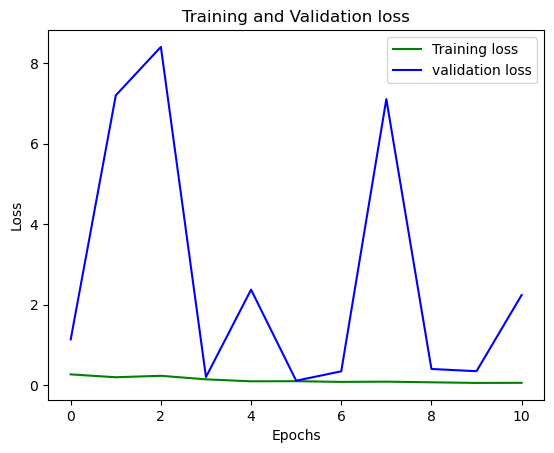

In [ ]:
loss_train = modelHistory.history['loss']
loss_val = modelHistory.history['val_loss']
epochs = range(len(loss_train))
plt.plot(epochs, loss_train, 'g', label='Training loss')
plt.plot(epochs, loss_val, 'b', label='validation loss')
plt.title('Training and Validation loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

### Training and Validation accuracy graph

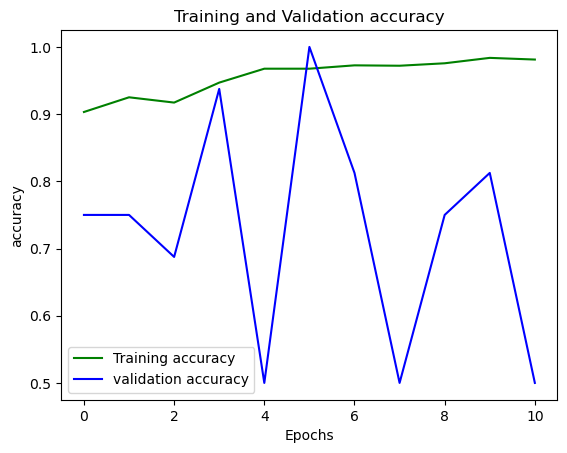

In [ ]:
acc_train = modelHistory.history['accuracy']
acc_val = modelHistory.history['val_accuracy']
epochs = range(len(acc_train))
plt.plot(epochs, acc_train, 'g', label='Training accuracy')
plt.plot(epochs, acc_val, 'b', label='validation accuracy')
plt.title('Training and Validation accuracy')
plt.xlabel('Epochs')
plt.ylabel('accuracy')
plt.legend()
plt.show()

### Evaluate the model on the test data
After we trained the model, we will evaluate it on the test data

In [ ]:
### Loading the best model 
from tensorflow.keras.models import load_model
loaded_model = load_model(os.getcwd() + r"\best_model.h5", options = load_options)

# Final evaluation of the model
loss, acc = loaded_model.evaluate(test_ds)
print("CNN Accuracy: %.2f%%" % (acc*100))

39/39 [==============================] - 5s 87ms/step - loss: 0.6013 - accuracy: 0.8317
CNN Accuracy: 83.17%
